In [3]:
from __future__ import print_function
import nibabel as nib
import numpy as np
from radiomics import featureextractor
import radiomics
import logging
radiomics.logger.setLevel(logging.ERROR)
import SimpleITK as sitk
from radiomics import firstorder, glcm, shape, glrlm, glszm, ngtdm, gldm
import numpy as np
import os
import pandas as pd
from glob import glob
import SimpleITK as sitk
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm_notebook
import SimpleITK  as sitk
import numpy as np
import os
from glob import glob
import matplotlib.pyplot as plt
import nibabel as nib


In [7]:
img_path = '/media/sc-mlsg/UBUNTU 20_0/sj/original/numpy_dataset/lung cancer_2018_contrast/1201117/CT_img.nii.gz'

In [30]:
mask_path = '/media/sc-mlsg/UBUNTU 20_0/sj/original/numpy_dataset/lung cancer_2018_contrast/1201117/c.nii.gz'

In [49]:
img = sitk.ReadImage(img_path)
print(img.GetSize())
mask = sitk.ReadImage(mask_path)
print(mask.GetSize())
feature , col = feature_extract(img, mask, 'D')


(512, 512, 380)
(512, 512, 380)


In [50]:
feature

[array(-876.),
 array(-396.),
 array(1.06321156e+09),
 array(3.7045565),
 array(150.),
 array(5.85342037),
 array(13.),
 array(-734.8380011),
 array(153.21982267),
 array(-829.),
 array(-914.),
 array(927.),
 array(82.38686957),
 array(764.10822065),
 array(1.9308527),
 array(6.36019073e+08),
 array(0.13458308),
 array(43874.48501391),
 array(98.3789259),
 array(222644.81251727),
 array(5204.7062311),
 array(206.55368285),
 array(22.01538594),
 array(0.8086768),
 array(2.95097121),
 array(3.12150032),
 array(12.96878405),
 array(0.47089218),
 array(0.41367671),
 array(0.98080306),
 array(0.92415855),
 array(-0.2200143),
 array(0.89738735),
 array(0.33933678),
 array(7.22670558),
 array(0.02952164),
 array(6.84290503),
 array(0.81871634),
 array(0.09227964),
 array(14.45341117),
 array(4.81154334),
 array(57.1422672),
 array(14.60486322),
 array(0.04439168),
 array(54.929426),
 array(213.35258359),
 array(1150.51975684),
 array(10519.69908815),
 array(206.67772136),
 array(0.06644204),


In [34]:
col

['original_firstorder_10Percentile',
 'original_firstorder_90Percentile',
 'original_firstorder_Energy',
 'original_firstorder_Entropy',
 'original_firstorder_InterquartileRange',
 'original_firstorder_Kurtosis',
 'original_firstorder_Maximum',
 'original_firstorder_Mean',
 'original_firstorder_MeanAbsoluteDeviation',
 'original_firstorder_Median',
 'original_firstorder_Minimum',
 'original_firstorder_Range',
 'original_firstorder_RobustMeanAbsoluteDeviation',
 'original_firstorder_RootMeanSquared',
 'original_firstorder_Skewness',
 'original_firstorder_TotalEnergy',
 'original_firstorder_Uniformity',
 'original_firstorder_Variance',
 'original_glcm_Autocorrelation',
 'original_glcm_ClusterProminence',
 'original_glcm_ClusterShade',
 'original_glcm_ClusterTendency',
 'original_glcm_Contrast',
 'original_glcm_Correlation',
 'original_glcm_DifferenceAverage',
 'original_glcm_DifferenceEntropy',
 'original_glcm_DifferenceVariance',
 'original_glcm_Id',
 'original_glcm_Idm',
 'original_glc

In [39]:
img = nib.load(img_path)
img_data = img.get_fdata()

mask = nib.load(mask_path)
mask_data = mask.get_fdata()

In [43]:
img = sitk.ReadImage(img_path)
print(img.GetSize())
mask = sitk.ReadImage(mask_path)
print(mask.GetSize())

img_data = sitk.GetArrayFromImage(img)
mask_data = sitk.GetArrayFromImage(mask)


(512, 512, 380)
(512, 512, 380)


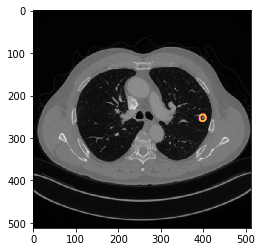

In [41]:
plt.imshow(img_data[:,:,].T , cmap = 'gray')
plt.contour(mask_data[:,:,].T, cmap = 'plasma') 

In [35]:
np.unique(mask_data, return_counts = True)

(array([  0., 255.]), array([99612899,     1821]))

In [44]:
target_img = img_data[mask_data == 255]
print(target_img.shape)

(1821,)


In [46]:
np.nanpercentile(target_img, 10, interpolation= 'linear')

-876.0

In [47]:
np.nanpercentile(target_img, 90, interpolation= 'linear')

-396.0

In [48]:
def feature_extract(image, mask, config, features = ['firstorder', 'glcm', 'glszm', 'glrlm', 'ngtdm', 'shape']):
    '''
    :param image_origin: image_array (numpy array)
    :param image_mask: mask_array (numpy array)
    :return: whole features, featureVector
    '''
    
    settings = {}
    settings['binCount'] = 32
    settings['resampledPixelSpacing'] = (2, 2, 2)
#     settings['resampledPixelSpacing'] = image.GetSpacing()
    settings['verbose'] = True
    settings['label'] = 255
    settings['resegmentMode'] = 'sigma'
    
    if config == 'E':
        clamp = sitk.ClampImageFilter()
        clamp.SetLowerBound(-1000)
        clamp.SetUpperBound(400)
        image = clamp.Execute(image)
        settings['interpolator'] = 'sitkBSpline'
    else:
        clamp = sitk.ClampImageFilter()
        clamp.SetLowerBound(-1000)
        clamp.SetUpperBound(400)
        image = clamp.Execute(image)
        settings['interpolator'] = 'sitkLinear'
        
    
    extractor = featureextractor.RadiomicsFeatureExtractor(**settings)
    extractor.settings['enableCExtensions'] = True
    
    for feature in features:
        extractor.enableFeatureClassByName(feature.lower())
        
    featureVector = extractor.execute(image, mask)
    
    cols = []; feats = []
    for feature in features:
        for featureName in sorted(featureVector.keys()):
            if feature in featureName:
                cols.append(featureName)
                feats.append(featureVector[featureName])
    return feats, cols

def ReadDicomSeries(dicom_dir):
    '''
    dicom_dir : dicom directory path
    '''
    
    reader = sitk.ImageSeriesReader()

    # Set Reader's File Names
    dicom_names = reader.GetGDCMSeriesFileNames(dicom_dir)
    print(dicom_names)
    reader.SetFileNames(dicom_names)

    # Get Image Object from Reader
    sitk_file = reader.Execute()
    
    return sitk_file
def subdir_finder(path):
    if 'contrast' in path:
        return [path]
    else:
        return glob(path+'/*')

In [5]:
orglist =sorted(glob('/media/sc-mlsg/UBUNTU 20_0/sj/original/numpy_dataset/*'))

In [6]:
cfg_D_df, cfg_E_df = pd.DataFrame(), pd.DataFrame()
print(cfg_D_df)

Empty DataFrame
Columns: []
Index: []


In [114]:
error = []
for CT_dirs in tqdm_notebook(orglist):
    patID = os.path.basename(CT_dirs)
    print(patID)
    # contrast = 'Noncontrast' if 'noncontrast'in CT_dir else 'Contrast'
    contrast = 'Contrast'

    # Mask finding
    mask_dir = []
    for (root, dirs, files) in os.walk(CT_dirs):
        for file in files:
            if file.endswith('nii.gz'):
                mask_dir.append(os.path.join(root, file))
    print(mask_dir)


    # Image finding
    for (root, _, files) in os.walk(CT_dirs):
        if len(files) > 20:
            CT_dcm_dir = root
            
            break
#     print(CT_dcm_dir)
#     path= CT_dcm_dir+'/*'
#     img_list=[]
#     for n,dcm in enumerate(sorted(glob(path))):
# #         print(dcm)
#         img = sitk.ReadImage(dcm)
# #         print(img.GetSize())
#         img_arr = sitk.GetArrayFromImage(img)[0]
# #         print(img_arr.shape)
#         img_list.append(img_arr)
#     CT_img= np.stack(img_list) 
#     CT_img = sitk.GetImageFromArray(CT_img)
#     print(CT_img)
    
        
    CT_img = ReadDicomSeries(CT_dcm_dir)
    print(CT_img)

#     # Container
    finished_mask_type = []
    cfg_D_feats_total, cfg_D_cols_total = [patID, contrast], ['ID', 'Contrast']

    for mask_path in mask_dir:
        
        mask_type = mask_path.split('/')[-1].split('.')[-3]
        print(mask_type)
        if mask_type not in finished_mask_type:
            mask = sitk.ReadImage(mask_dir[2])
#             CT_img = sitk.GetImageFromArray(CT_img)
    ###ImageCheckPlot###
#     mask_arr = sitk.GetArrayFromImage(mask)/255
#     print(mask_arr.shape)
    
#     for m in range(CT_img.shape[0]):
#         if len(np.unique(mask_arr[m, :, :])) > 1:
#             plt.figure(figsize=(20,20))
#             plt.imshow(CT_img[m, :, :])
#             plt.contour(mask_arr[m, :, :].transpose(),cmap='plasma')
#             plt.show()
            
        
#         ax = plt.subplot(100,4,m+1)
# #         print(CT_img[m].shape)
# #         print(mask_arr[m].shape)
#         ax.imshow(CT_img[m])
#         ax.imshow(mask_arr[m],alpha=.2)

#         if mask_arr.sum()>1: 
#             plt.subplot(1,2,1),plt.imshow(CT_img[m])
#             plt.subplot(1,2,2),plt.imshow(mask_arr[m])
# #             print(dcm)

# #         if n > 10:
# #             break

#             plt.show()
            
            
            print('CT', CT_img.GetSize(), CT_img.GetSpacing())
            print('Mask', mask.GetSize(), mask.GetSpacing())
            
            if CT_img.GetSize()[2] !=mask.GetSize()[2]:
                print(CT_img.GetSize()[2])
                error.append(mask_path)
                pass
            cfg_D_feats, cfg_D_cols = feature_extract(CT_img, mask, 'D')
            # cfg_E_feats, cfg_E_cols = feature_extract(CT_img, mask, 'E')

            cfg_D_cols = [mask_type+'_mask_'+col.lstrip('original_') for col in cfg_D_cols]
            # cfg_E_cols = [mask_type+'_mask_'+col.lstrip('original_') for col in cfg_E_cols]

            cfg_D_feats_total += cfg_D_feats
            # cfg_E_feats_total += cfg_E_feats
            cfg_D_cols_total  += cfg_D_cols
            # cfg_E_cols_total  += cfg_E_cols

            finished_mask_type.append(mask_type)

        # except Exception as e:
        #     print("Error for %s\n\n" % CT_dirs, e)

    cfg_D_row = pd.DataFrame([cfg_D_feats_total], columns=cfg_D_cols_total)
    # cfg_E_row = pd.DataFrame([cfg_E_feats_total], columns=cfg_E_cols_total)

    cfg_D_df = pd.concat([cfg_D_df, cfg_D_row])
        # cfg_E_df = pd.concat([cfg_E_df, cfg_E_row])


        # except Exception as e:
        #     print("Error for %s (%s)\n\n" % (CT_dir, e))

1201117
['./numpy_dataset/lung cancer_2018_contrast/1201117/c.nii.gz', './numpy_dataset/lung cancer_2018_contrast/1201117/p.nii.gz', './numpy_dataset/lung cancer_2018_contrast/1201117/n.nii.gz']
Image (0x555d8533d7e0)
  RTTI typeinfo:   itk::Image<short, 3u>
  Reference Count: 1
  Modified Time: 6168665
  Debug: Off
  Object Name: 
  Observers: 
    none
  Source: (none)
  Source output name: (none)
  Release Data: Off
  Data Released: False
  Global Release Data: Off
  PipelineMTime: 6156057
  UpdateMTime: 6168664
  RealTimeStamp: 0 seconds 
  LargestPossibleRegion: 
    Dimension: 3
    Index: [0, 0, 0]
    Size: [512, 512, 380]
  BufferedRegion: 
    Dimension: 3
    Index: [0, 0, 0]
    Size: [512, 512, 380]
  RequestedRegion: 
    Dimension: 3
    Index: [0, 0, 0]
    Size: [512, 512, 380]
  Spacing: [0.773438, 0.773438, 1]
  Origin: [-196.613, -340.113, 600.2]
  Direction: 
1 0 0
0 1 0
0 0 1

  IndexToPointMatrix: 
0.773438 0 0
0 0.773438 0
0 0 1

  PointToIndexMatrix: 
1.29293 0

KeyboardInterrupt: 

In [ ]:
img_data
mask_data

target_data = img_data[mask_data == 255]

if np.unique(mask_data, return_counts = True)[1][1] == len(target_data.ravel(order = 'C')):
    max_intensity = np.max(target_data)
    min_intensity = np.min(target_data)



1201117
['./numpy_dataset/lung cancer_2018_contrast/1201117/c.nii.gz', './numpy_dataset/lung cancer_2018_contrast/1201117/p.nii.gz', './numpy_dataset/lung cancer_2018_contrast/1201117/n.nii.gz']
./numpy_dataset/lung cancer_2018_contrast/1201117/CT_20180207/0005_20180207_094656
c
(-196.61328125, -340.11328125, 600.2000122070312)
(1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0)
(0.7734375, 0.7734375, 1.0)
(-196.61328125, -340.11328125, 600.2000122070312)
(1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0)
(0.7734375, 0.7734375, 1.0)
(380, 512, 512)


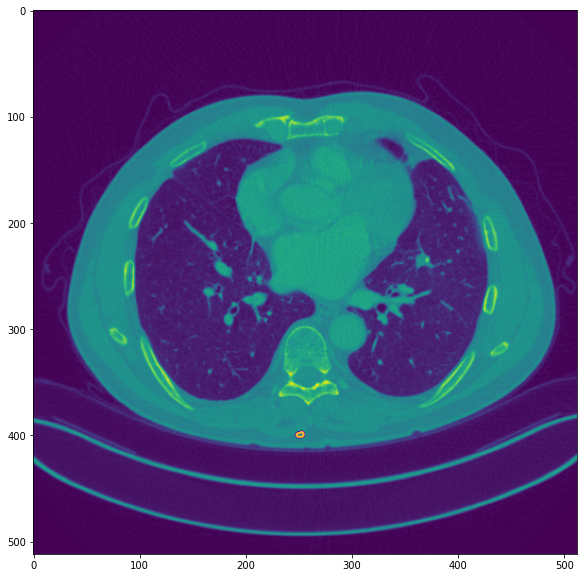

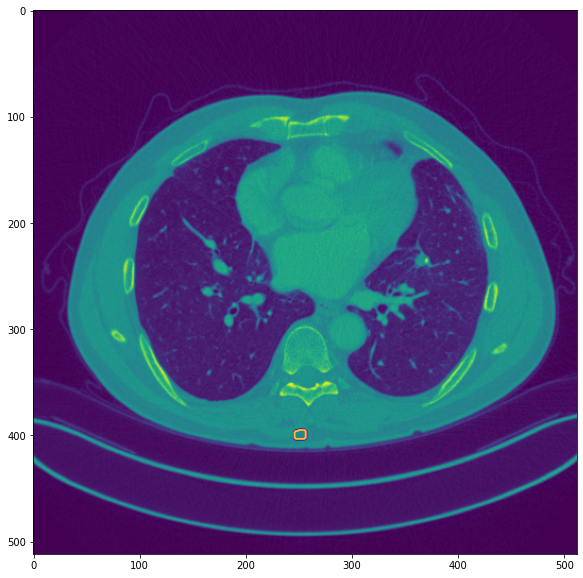

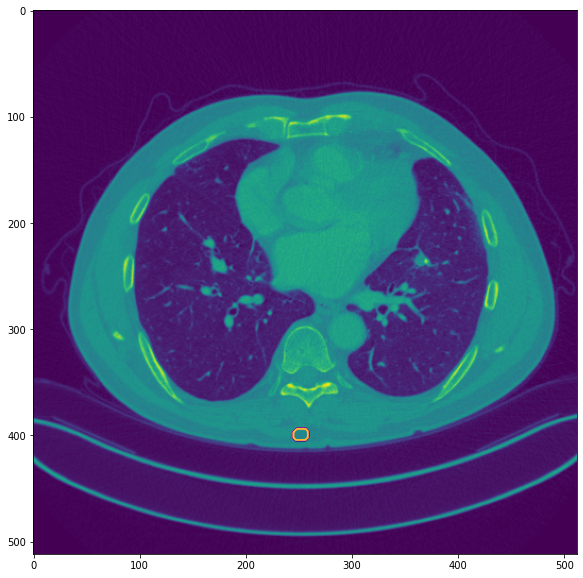

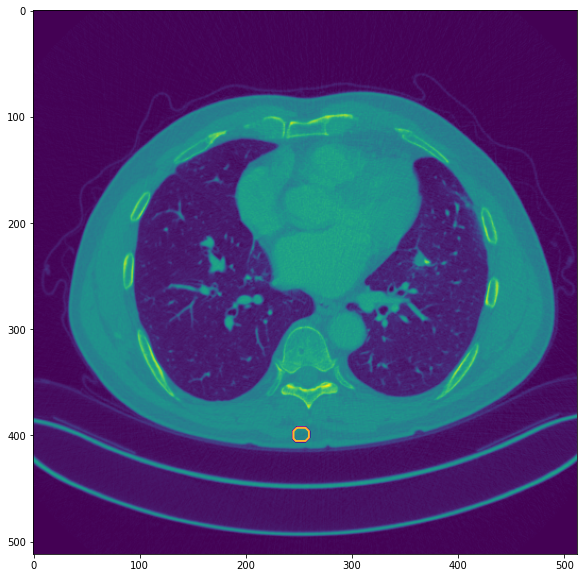

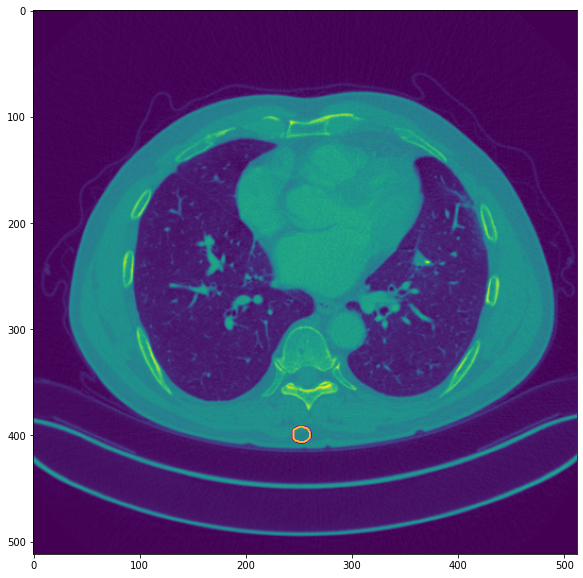

...

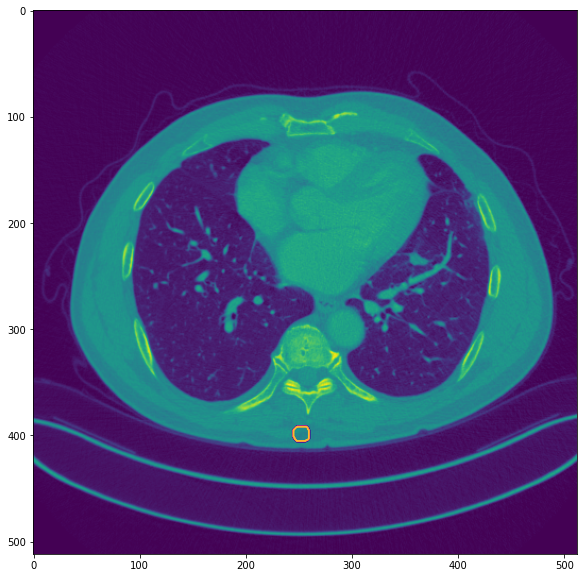

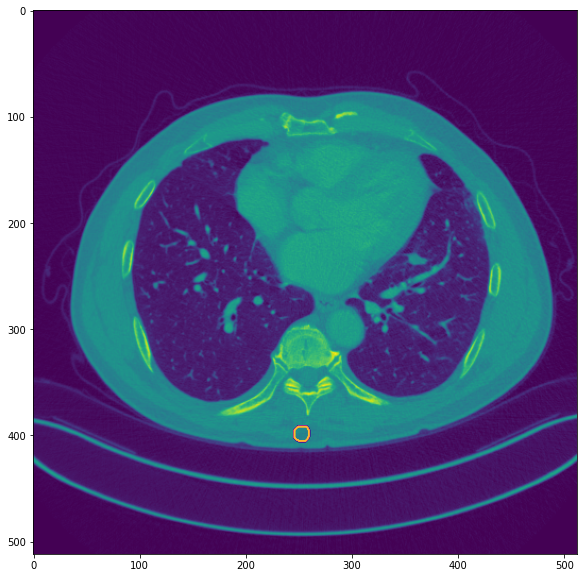

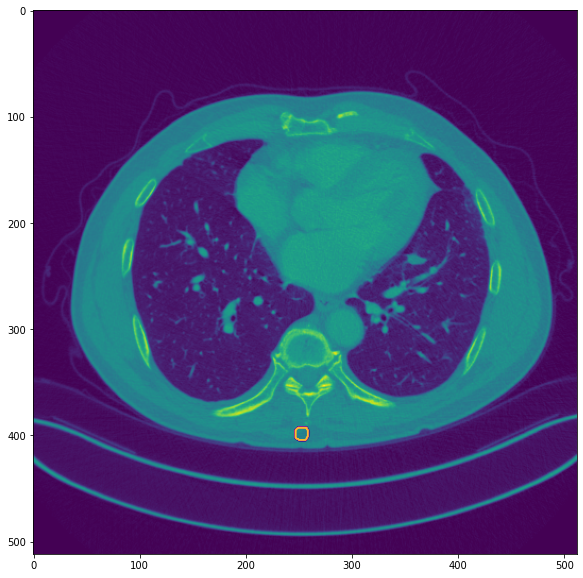

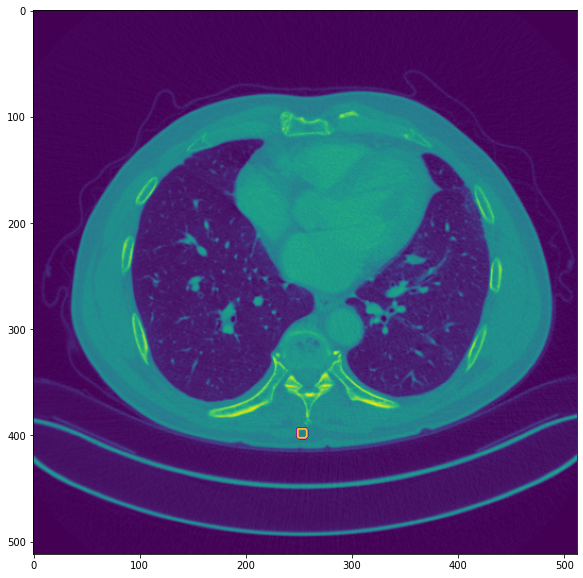

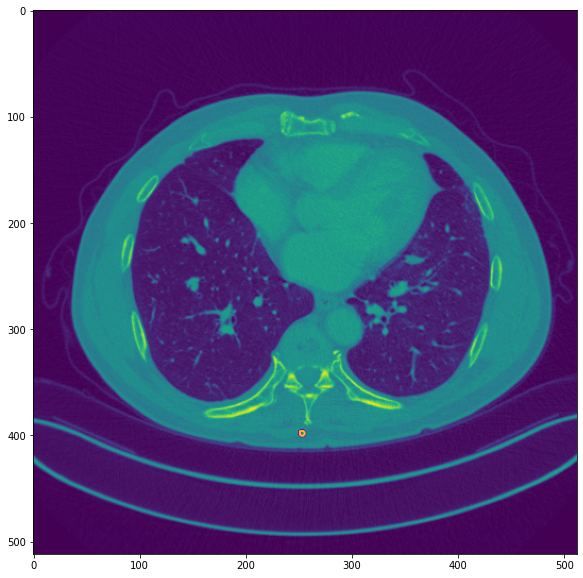

p
(-196.61328125, -340.11328125, 600.2000122070312)
(1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0)
(0.7734375, 0.7734375, 1.0)
(-196.61328125, -340.11328125, 600.2000122070312)
(1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0)
(0.7734375, 0.7734375, 1.0)
(380, 512, 512)


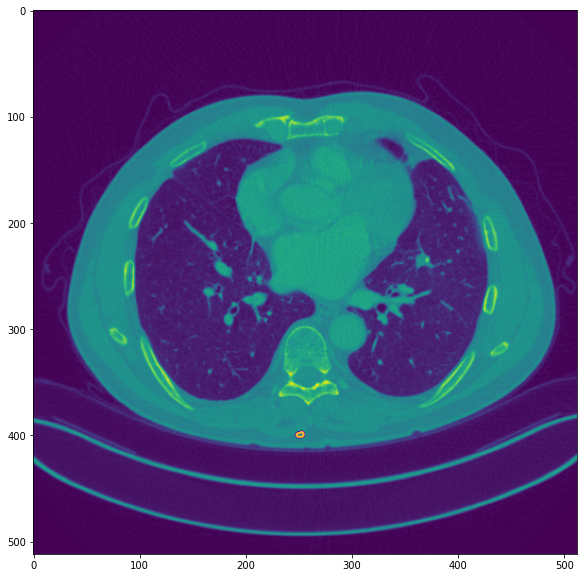

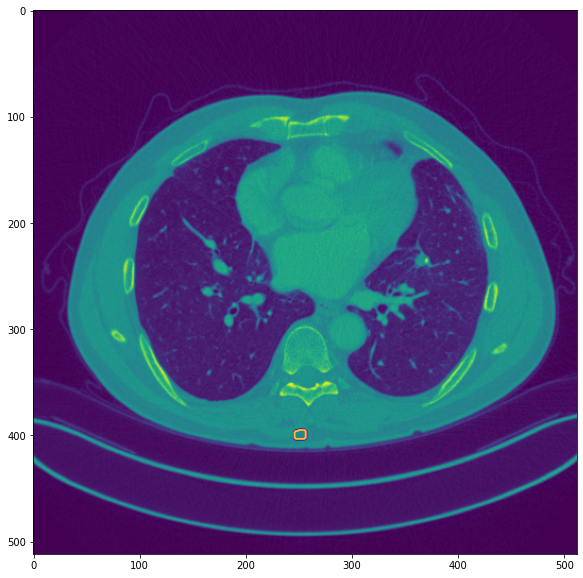

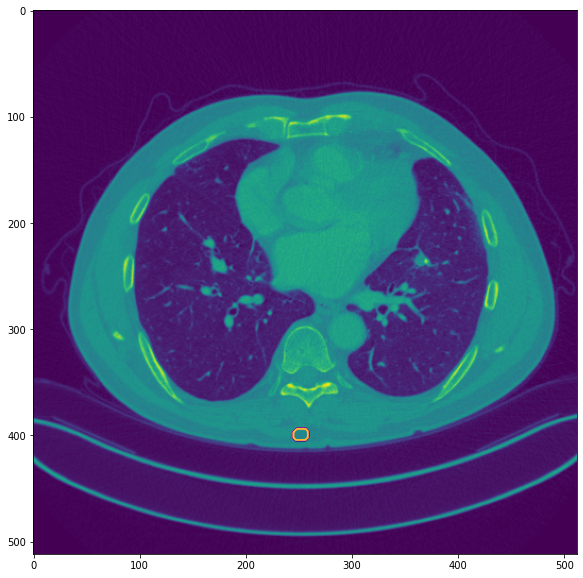

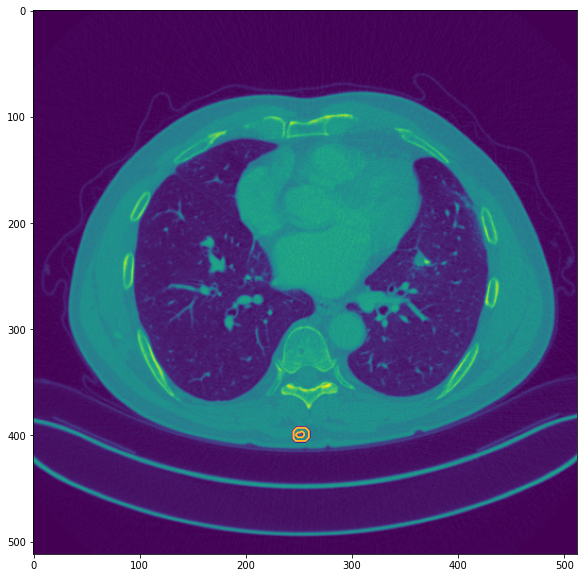

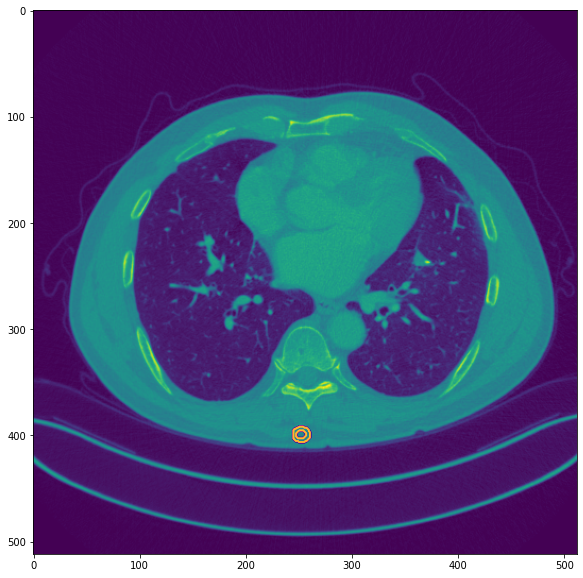

...

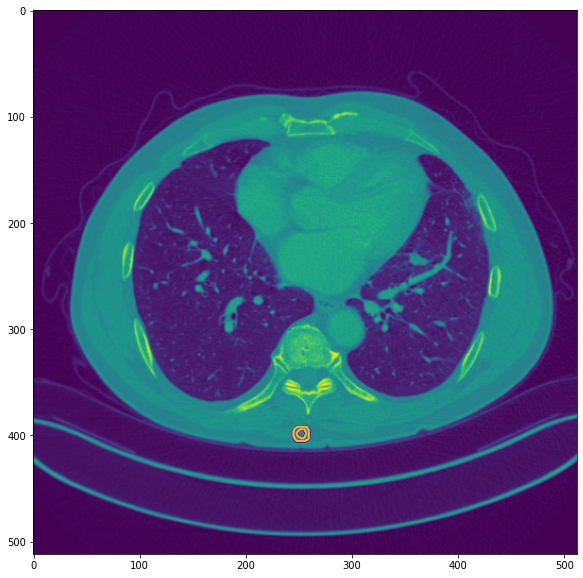

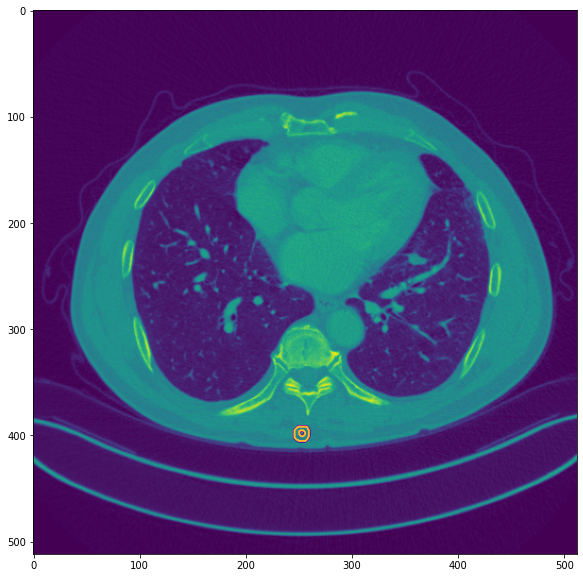

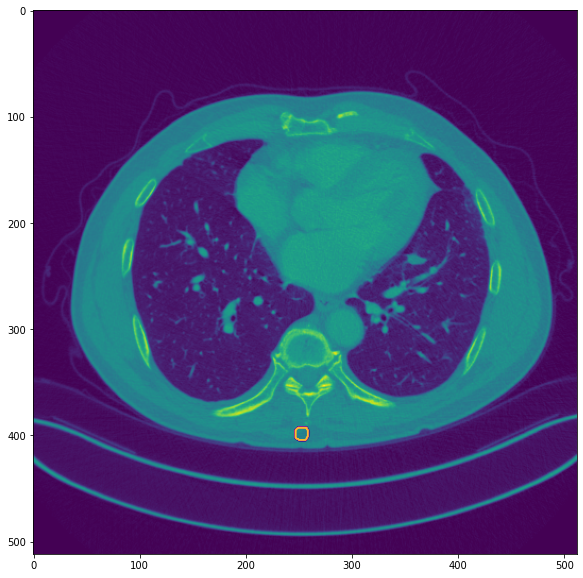

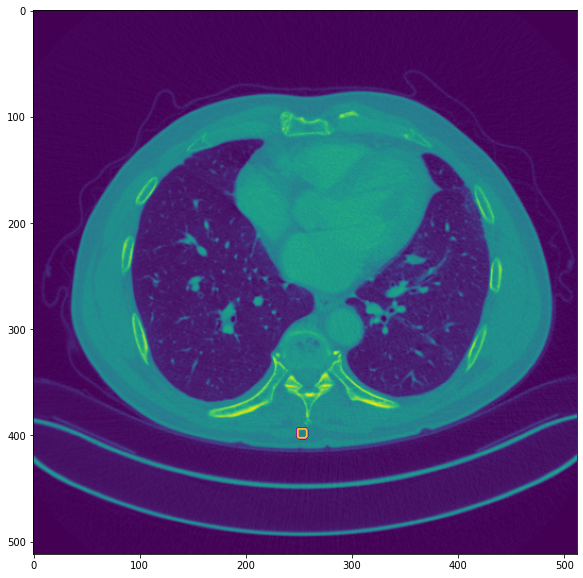

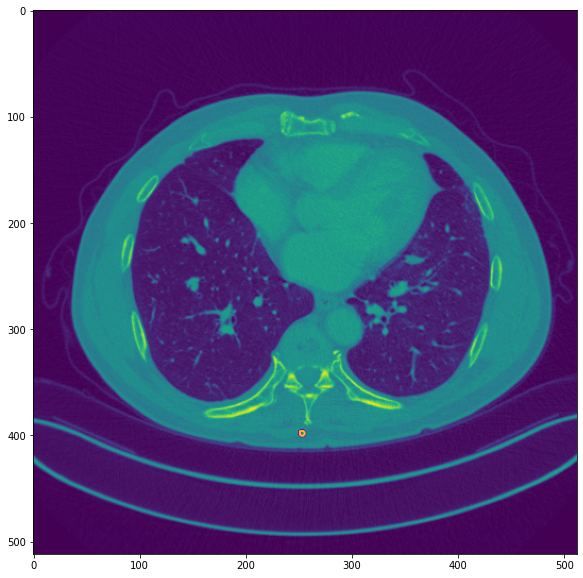

n
(-196.61328125, -340.11328125, 600.2000122070312)
(1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0)
(0.7734375, 0.7734375, 1.0)
(-196.61328125, -340.11328125, 600.2000122070312)
(1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0)
(0.7734375, 0.7734375, 1.0)
(380, 512, 512)


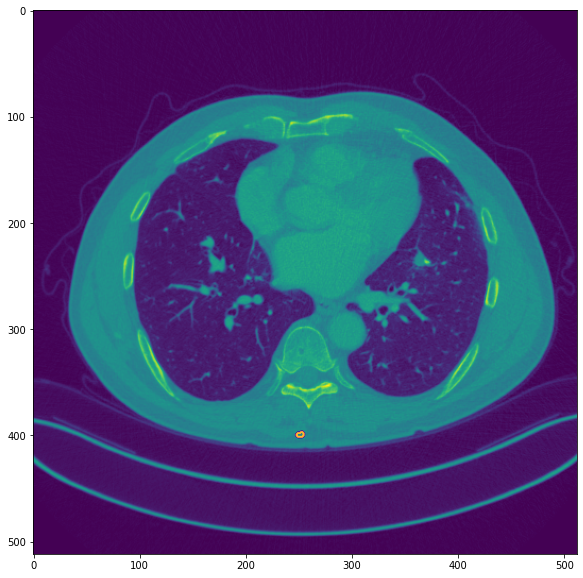

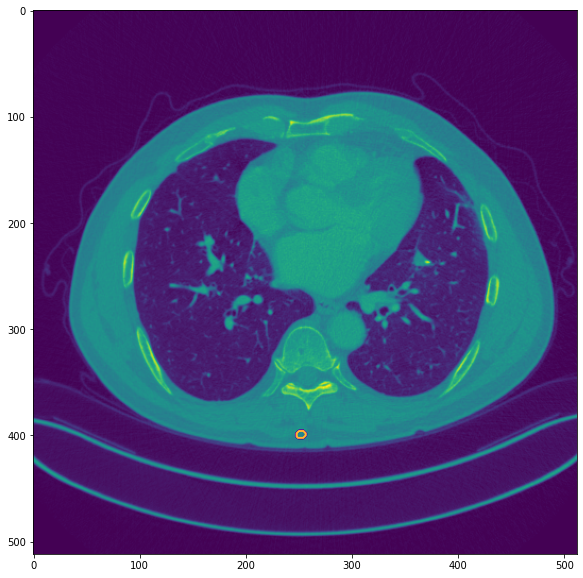

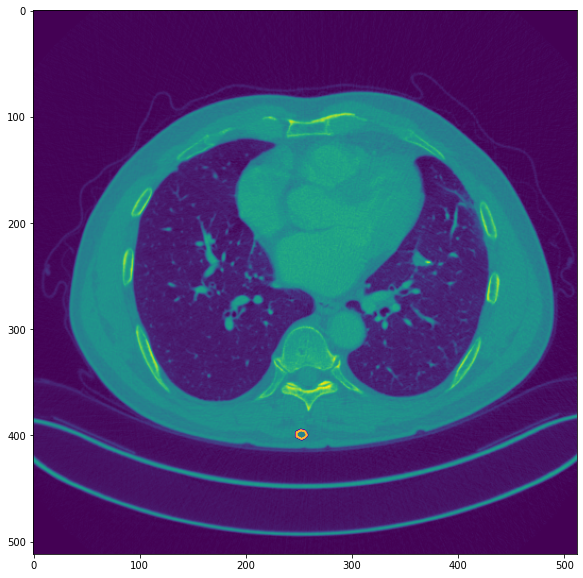

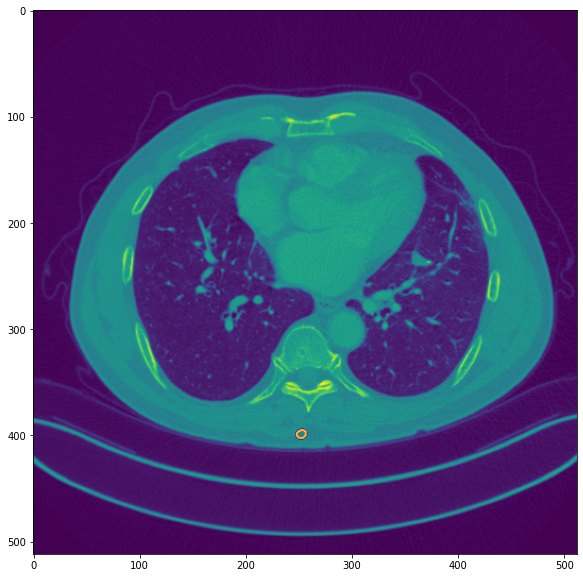

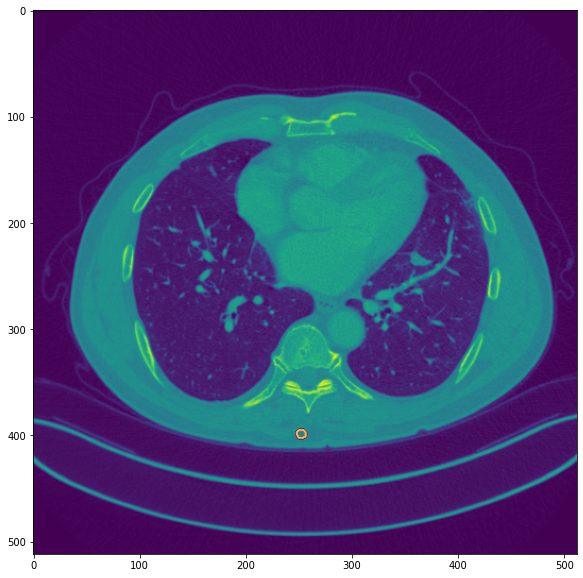

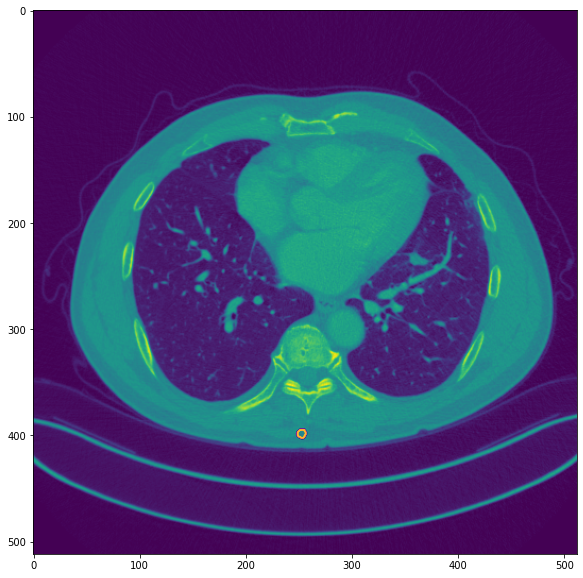

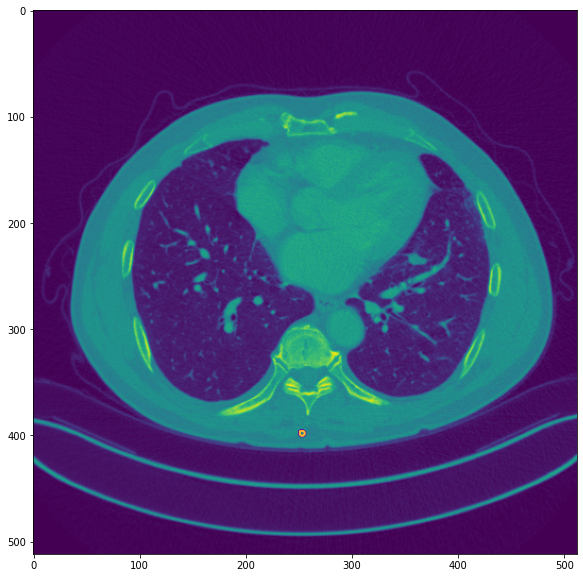

1529073
['./numpy_dataset/lung cancer_2018_contrast/1529073/c.nii.gz', './numpy_dataset/lung cancer_2018_contrast/1529073/p.nii.gz', './numpy_dataset/lung cancer_2018_contrast/1529073/n.nii.gz']
./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323
c
(-193.1759796142578, -178.9871063232422, -378.625)
(1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0)
(0.7519530057907104, 0.7519530057907104, 1.0)
(-193.1759796142578, -178.9871063232422, -378.625)
(1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0)
(0.7519530057907104, 0.7519530057907104, 1.0)
(467, 512, 512)


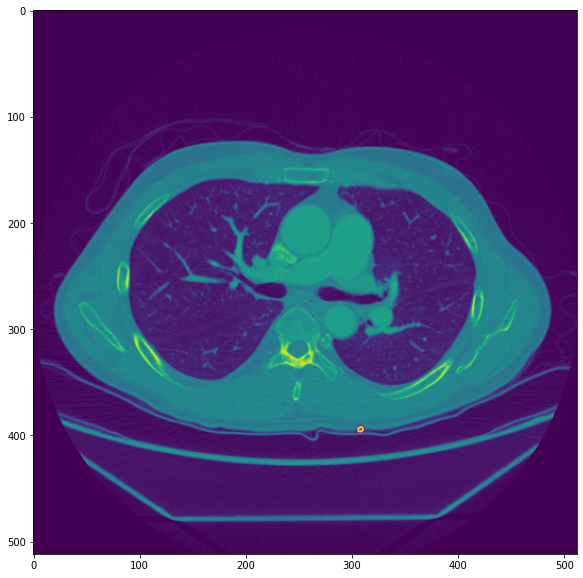

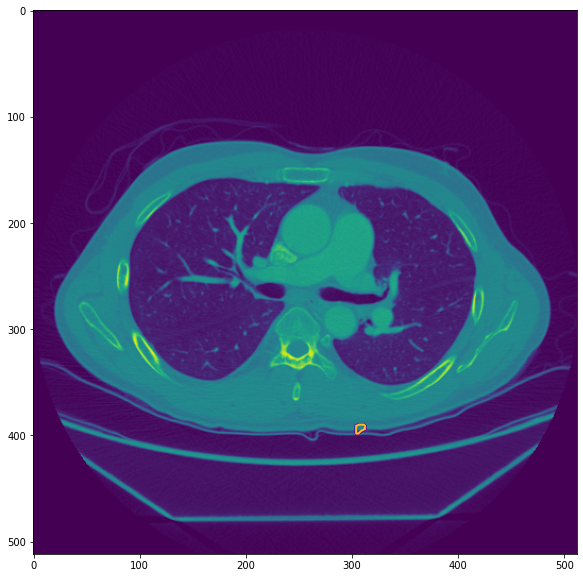

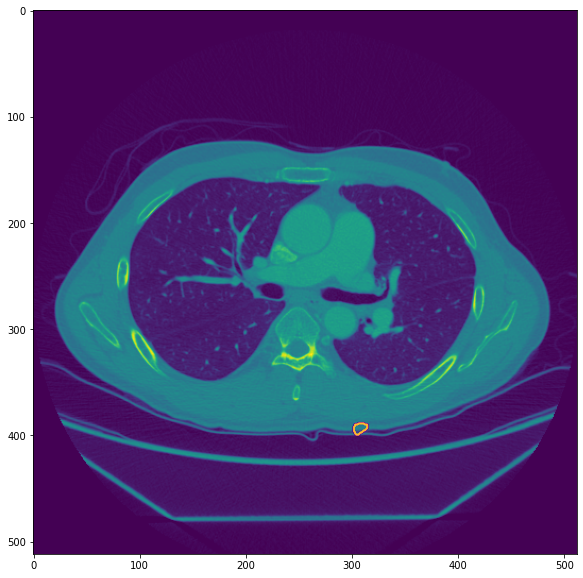

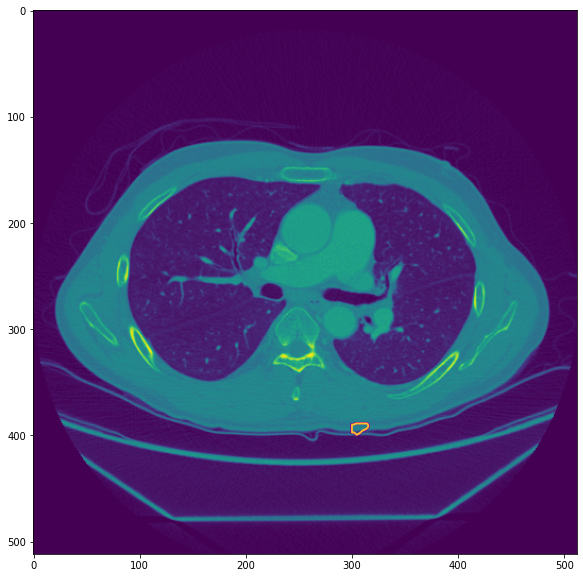

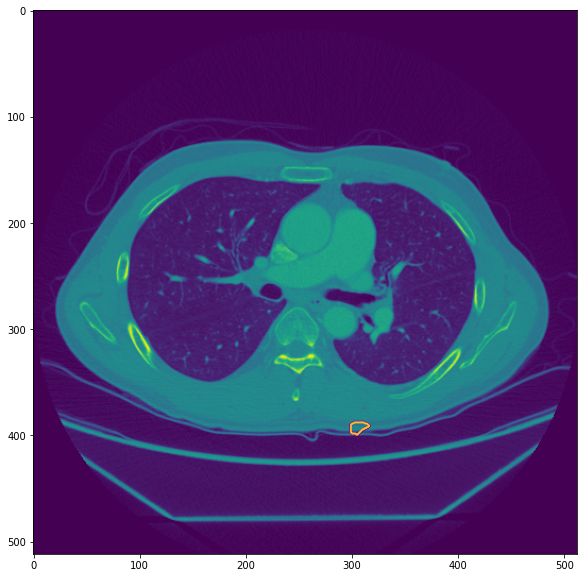

...

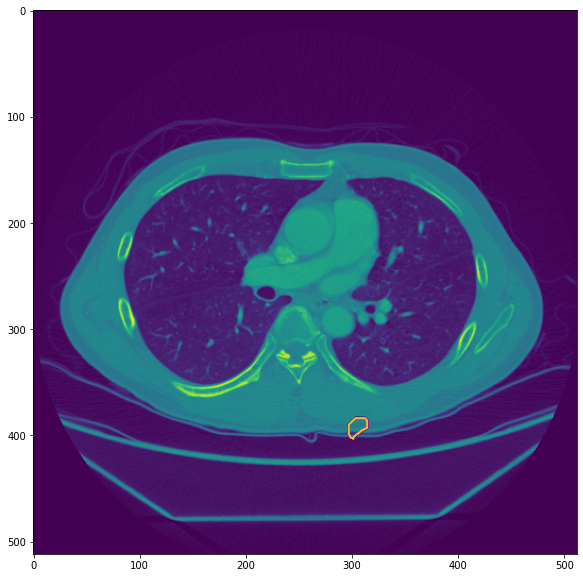

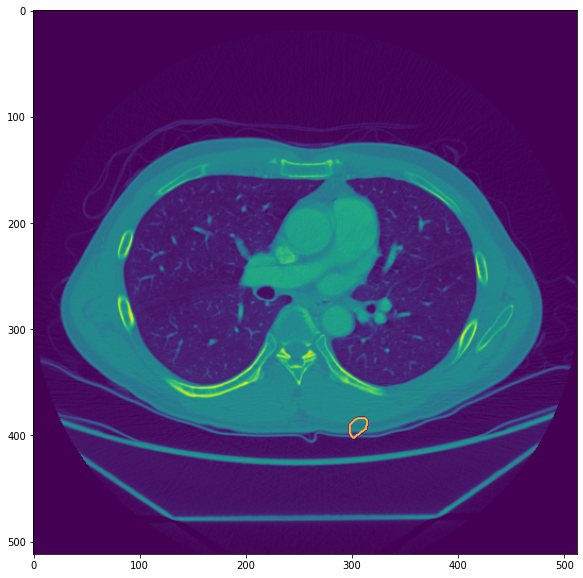

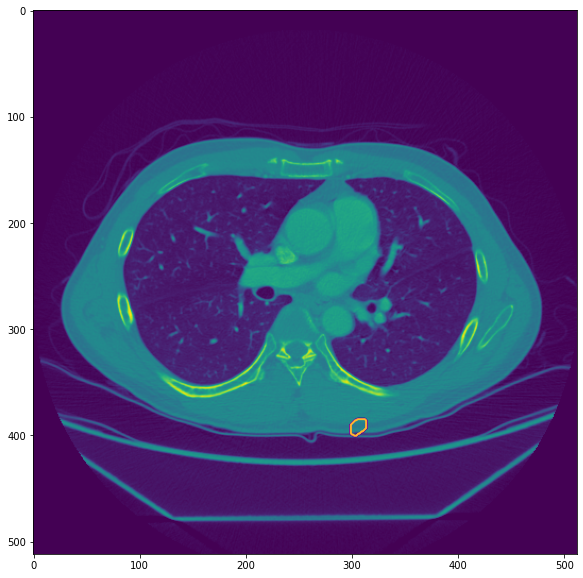

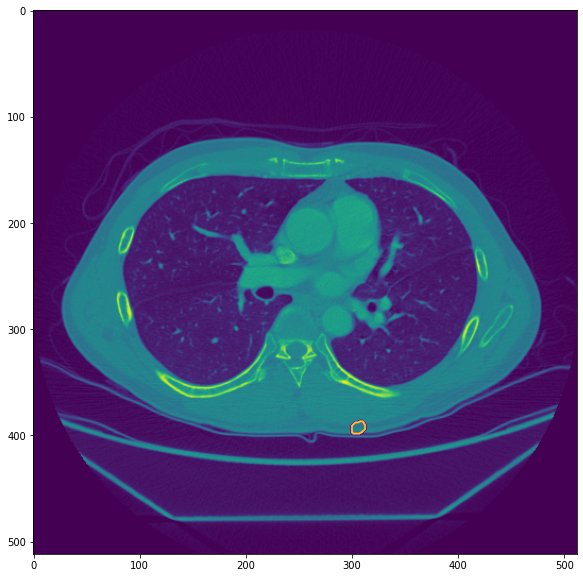

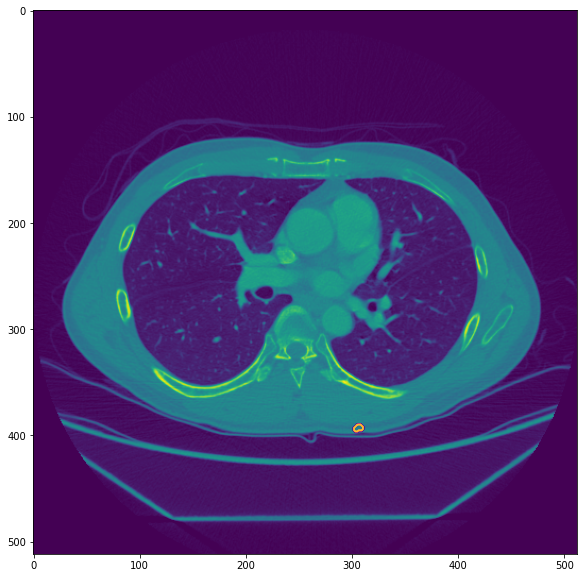

IndexError: index 467 is out of bounds for axis 0 with size 467

In [136]:
error = []
cfg_D_df, cfg_E_df = pd.DataFrame(), pd.DataFrame()
for CT_dirs in tqdm_notebook(orglist):
    patID = os.path.basename(CT_dirs)
    print(patID)
    # contrast = 'Noncontrast' if 'noncontrast'in CT_dir else 'Contrast'
    contrast = 'Contrast'

    # Mask finding
    mask_dir = []
    for (root, dirs, files) in os.walk(CT_dirs):
        new_files =  [file for file in files if 'CT_img' not in file]
        for file in new_files:
            if file.endswith('nii.gz'):
                mask_dir.append(os.path.join(root, file))
    print(mask_dir)


    # Image finding
    for (root, _, files) in os.walk(CT_dirs):
        if len(files) > 20:
            CT_dcm_dir = root
            
            break
    print(CT_dcm_dir)
    path= CT_dcm_dir+'/*'
    img_list=[]
    for n,dcm in enumerate(sorted(glob(path))):
#         print(dcm)
        img = sitk.ReadImage(dcm)
        
#         print(img.GetSize())
        img_arr = sitk.GetArrayFromImage(img)[0]
#         print(img_arr.shape)
        img_list.append(img_arr)
    CT_img= np.stack(img_list) 
    CT_img = sitk.GetImageFromArray(CT_img)
    
    
    
#     print(CT_img)
    
        
#     CT_img = ReadDicomSeries(CT_dcm_dir)
    

#     # Container
    finished_mask_type = []
    cfg_D_feats_total, cfg_D_cols_total = [patID, contrast], ['ID', 'Contrast']

    for mask_path in mask_dir:
        
        mask_type = mask_path.split('/')[-1].split('.')[-3]
        print(mask_type)
        if mask_type not in finished_mask_type:
            mask = sitk.ReadImage(mask_path)
            
            print(mask.GetOrigin())
            print(mask.GetDirection())
            print(mask.GetSpacing())

            CT_img.SetOrigin(mask.GetOrigin())
            CT_img.SetDirection(mask.GetDirection())
            CT_img.SetSpacing(mask.GetSpacing())
            
            print(CT_img.GetOrigin())
            print(CT_img.GetDirection())
            print(CT_img.GetSpacing())
                


#             sitk.WriteImage(CT_img, os.path.join(CT_dirs, 'CT_img.nii.gz'))

            ###ImageCheckPlot###
            mask_arr = sitk.GetArrayFromImage(mask)/255
            print(mask_arr.shape)
            img_data = sitk.GetArrayFromImage(CT_img)
            for m in range(img_data.shape[0]):
                if len(np.unique(mask_arr[m, :, :])) > 1:
                    plt.figure(figsize=(10,10))
                    plt.imshow(img_data[m, :, :])
                    plt.contour(mask_arr[m, :, :].transpose(),cmap='plasma')
#                     plt.contour(mask_arr[m, :, :].T.transpose(),cmap='plasma')
                    plt.show()


#                 ax = plt.subplot(100,4,m+1)
#         #         print(CT_img[m].shape)
#         #         print(mask_arr[m].shape)
#                 ax.imshow(CT_img[m])
#                 ax.imshow(mask_arr[m],alpha=.2)

#                 if mask_arr.sum()>1: 
#                     plt.subplot(1,2,1),plt.imshow(CT_img[m])
#                     plt.subplot(1,2,2),plt.imshow(mask_arr[m])
#         #             print(dcm)

#         #         if n > 10:
#         #             break

            
            
#             print('CT', CT_img.GetSize(), CT_img.GetSpacing())
#             print('Mask', mask.GetSize(), mask.GetSpacing())
            
#             if CT_img.GetSize()[2] !=mask.GetSize()[2]:
#                 print(CT_img.GetSize()[2])
#                 error.append(mask_path)
#                 pass
            
#             mask_data = sitk.GetArrayFromImage(mask)
#             img_data = sitk.GetArrayFromImage(CT_img)
            
#             target_data = img_data[mask_data == 255]

#             if np.unique(mask_data, return_counts = True)[1][1] == len(target_data.ravel(order = 'C')):
#                 max_intensity = np.max(target_data)
#                 min_intensity = np.min(target_data)
#                 print(max_intensity,min_intensity)
                
#             cfg_D_feats, cfg_D_cols = feature_extract(CT_img, mask, 'D')
#             # cfg_E_feats, cfg_E_cols = feature_extract(CT_img, mask, 'E')

#             cfg_D_cols = [mask_type+'_mask_'+col.lstrip('original_') for col in cfg_D_cols]
#             # cfg_E_cols = [mask_type+'_mask_'+col.lstrip('original_') for col in cfg_E_cols]

#             cfg_D_feats_total += cfg_D_feats
#             # cfg_E_feats_total += cfg_E_feats
#             cfg_D_cols_total  += cfg_D_cols
#             # cfg_E_cols_total  += cfg_E_cols

#             finished_mask_type.append(mask_type)

#         # except Exception as e:
#         #     print("Error for %s\n\n" % CT_dirs, e)

#     cfg_D_row = pd.DataFrame([cfg_D_feats_total], columns=cfg_D_cols_total)
#     # cfg_E_row = pd.DataFrame([cfg_E_feats_total], columns=cfg_E_cols_total)

#     cfg_D_df = pd.concat([cfg_D_df, cfg_D_row])
#         # cfg_E_df = pd.concat([cfg_E_df, cfg_E_row])


#         # except Exception as e:
#         #     print("Error for %s (%s)\n\n" % (CT_dir, e))

In [125]:
test_img_path = './numpy_dataset/lung cancer_2018_contrast/1201117/CT_img.nii.gz'
test_img = sitk.ReadImage(test_img_path)

print(test_img.GetSpacing())

(0.7734375, 0.7734375, 1.0)


In [127]:
cfg_D_df

,ID,Contrast,c_mask_firstorder_10Percentile,c_mask_firstorder_90Percentile,c_mask_firstorder_Energy,c_mask_firstorder_Entropy,c_mask_firstorder_InterquartileRange,c_mask_firstorder_Kurtosis,c_mask_firstorder_Maximum,c_mask_firstorder_Mean,...,n_mask_shape_Maximum2DDiameterColumn,n_mask_shape_Maximum2DDiameterRow,n_mask_shape_Maximum2DDiameterSlice,n_mask_shape_Maximum3DDiameter,n_mask_shape_MeshVolume,n_mask_shape_MinorAxisLength,n_mask_shape_Sphericity,n_mask_shape_SurfaceArea,n_mask_shape_SurfaceVolumeRatio,n_mask_shape_VoxelVolume
0,1201117,Contrast,-676.6,-108.0,4210214.0,3.8820451081368574,245.0,2.1088399199682595,-32.0,-378.0,...,8.246211251235321,8.94427190999916,8.0,9.16515138991168,153.33333333333334,6.469011,0.8696368337655443,159.3078768361127,1.038964414148561,184.0
0,1201117,Contrast,-676.6,-108.0,4210214.0,3.8820451081368574,245.0,2.1088399199682595,-32.0,-378.0,...,8.246211251235321,8.94427190999916,8.0,9.16515138991168,153.33333333333334,6.469011,0.8696368337655443,159.3078768361127,1.038964414148561,184.0
0,1529073,Contrast,-564.4,74.80000000000001,8576373.0,4.483158943766899,451.0,1.8981923671761494,123.0,-217.62337662337663,...,12.649110640673518,14.422205101855956,13.416407864998739,14.966629547095765,564.3333333333334,10.531998,0.7808086029577448,422.9574415070154,0.7494815856592121,616.0
0,167043,Contrast,-794.0,-519.9,50901376.0,4.433956632534229,141.75,3.2020057399538384,-299.0,-647.4067796610169,...,15.231546211727817,13.416407864998739,15.231546211727817,15.748015748023622,891.6666666666666,11.854252,0.8294885843763846,540.1015190033803,0.6057213297234172,944.0
0,1201117,Contrast,-855.4,-589.6000000000001,79762258.0,3.6431296221510627,76.0,8.100540560946415,-236.0,-763.8947368421053,...,8.246211251235321,8.94427190999916,8.0,9.16515138991168,153.33333333333334,6.469011,0.8696368337655443,159.3078768361127,1.038964414148561,184.0


['./numpy_dataset/lung cancer_2018_contrast/1529073/c.nii.gz', './numpy_dataset/lung cancer_2018_contrast/1529073/p.nii.gz', './numpy_dataset/lung cancer_2018_contrast/1529073/n.nii.gz', './numpy_dataset/lung cancer_2018_contrast/1529073/c.npy', './numpy_dataset/lung cancer_2018_contrast/1529073/n.npy', './numpy_dataset/lung cancer_2018_contrast/1529073/p.npy', './numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721']
468
467
./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/IN_00001_0000047559.dcm
./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/IN_00002_0000047562.dcm
./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/IN_00003_0000047561.dcm
./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/IN_00004_0000047560.dcm
./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/IN_00005_0000047564.dcm
./numpy_da

./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/IN_00072_0000047630.dcm
./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/IN_00073_0000047631.dcm
./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/IN_00074_0000047633.dcm
./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/IN_00075_0000047632.dcm
./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/IN_00076_0000047634.dcm
./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/IN_00077_0000047635.dcm
./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/IN_00078_0000047637.dcm
./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/IN_00079_0000047636.dcm
./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/IN_00080_0000047638.dcm
./numpy_da

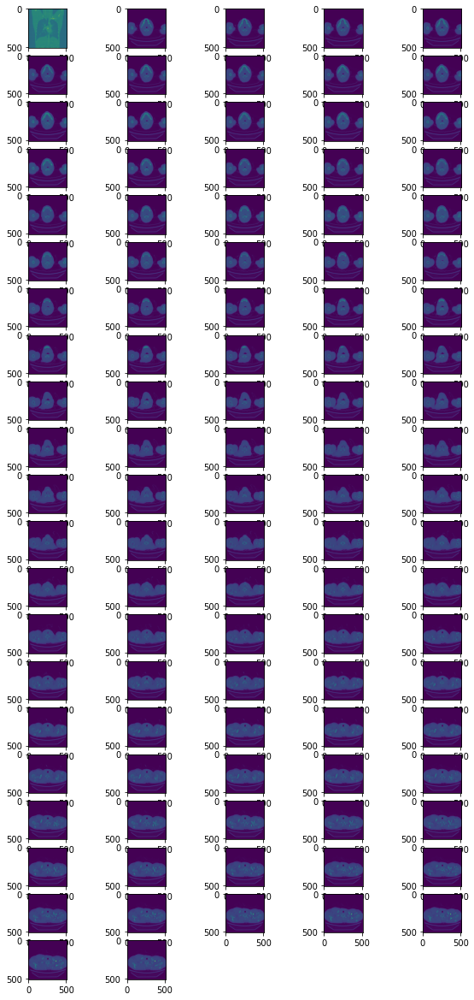

In [8]:
from glob import glob

path = "./numpy_dataset/lung cancer_2018_contrast/1529073/*"
file = glob(path)
print(file)

mask = sitk.ReadImage('./numpy_dataset/lung cancer_2018_contrast/1529073/p.nii.gz')
mask_arr = sitk.GetArrayFromImage(mask)

print(len(glob('./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/*')))
print(len(mask_arr))

plt.figure(figsize=(10,100))

for n,dcm in enumerate(sorted(glob('./numpy_dataset/lung cancer_2018_contrast/1529073/45665_20180721/0601_20180721_073323/*'))):
    dcm_ = sitk.ReadImage(dcm)
    dcm_arr = sitk.GetArrayFromImage(dcm_)
    
    ax = plt.subplot(100,5,n+1)

    ax.imshow(dcm_arr[0])
    ax.imshow(mask_arr[n],alpha=.2)
    
    if mask_arr.sum()>1: 
        print(dcm)
    
    if n > 100:
        break

plt.show()
    
    
    

In [11]:
cfg_D_df

,ID,Contrast,c_mask_firstorder_10Percentile,c_mask_firstorder_90Percentile,c_mask_firstorder_Energy,c_mask_firstorder_Entropy,c_mask_firstorder_InterquartileRange,c_mask_firstorder_Kurtosis,c_mask_firstorder_Maximum,c_mask_firstorder_Mean,...,n_mask_shape_Maximum2DDiameterColumn,n_mask_shape_Maximum2DDiameterRow,n_mask_shape_Maximum2DDiameterSlice,n_mask_shape_Maximum3DDiameter,n_mask_shape_MeshVolume,n_mask_shape_MinorAxisLength,n_mask_shape_Sphericity,n_mask_shape_SurfaceArea,n_mask_shape_SurfaceVolumeRatio,n_mask_shape_VoxelVolume
0,1201117,Contrast,-870.5999999999999,-414.0000000000001,76841153.0,3.620786848016948,151.0,5.549782318851848,-32.0,-733.015037593985,...,8.246211251235321,8.94427190999916,8.0,9.16515138991168,153.33333333333334,6.469011,0.8696368337655443,159.3078768361127,1.038964414148561,184.0
0,1201117,Contrast,-870.5999999999999,-414.0000000000001,76841153.0,3.620786848016948,151.0,5.549782318851848,-32.0,-733.015037593985,...,8.246211251235321,8.94427190999916,8.0,9.16515138991168,153.33333333333334,6.469011,0.8696368337655443,159.3078768361127,1.038964414148561,184.0


In [9]:
for m in glob(data_root):
    print(m)
    
    mask= sitk.ReadImage(m)
    mask= sitk.GetArrayFromImage(mask)
    print(mask.shape)
    
#     plt.imshow(mask)
#     plt.show()

/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8653172/c.nii.gz
(336, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8653172/p.nii.gz
(336, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8653172/n.nii.gz
(336, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/5236870/c.nii.gz
(371, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/5236870/p.nii.gz
(371, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/5236870/n.nii.gz
(371, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/7352134/c.nii.gz
(487, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/7352134/p.nii.gz
(487, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/7352134/n.nii.gz
(487, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8559150/c.nii.gz
(475, 512, 512)
/home/ccids-sw/Desktop/sw/prof

/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8338881/p.nii.gz
(310, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8338881/n.nii.gz
(310, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8627327/c.nii.gz
(421, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8627327/p.nii.gz
(421, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8627327/n.nii.gz
(421, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8659865/c.nii.gz
(351, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8659865/p.nii.gz
(351, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8659865/n.nii.gz
(351, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/7165978/c.nii.gz
(373, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/7165978/p.nii.gz
(373, 512, 512)
/home/ccids-sw/Desktop/sw/prof

(471, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/5204753/n.nii.gz
(471, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/7371435/c.nii.gz
(490, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/7371435/p.nii.gz
(490, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/7371435/n.nii.gz
(490, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8720273/c.nii.gz
(374, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8720273/p.nii.gz
(374, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8720273/n.nii.gz
(374, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8535322/c.nii.gz
(371, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8535322/p.nii.gz
(371, 512, 512)
/home/ccids-sw/Desktop/sw/prof_com/sj/lung cancer_2018_contrast/8535322/n.nii.gz
(371, 512, 512)
/home/ccids-sw

(374, 512, 512)


In [14]:
total = 0

for (path, dirs, files) in os.walk(data_root):
    if files != []:
        target_file_lst = glob(os.path.join(path, '*.nii.gz*'))
        
        if len(target_file_lst) == 0:
            continue
            
        total += 1
        pt = os.path.basename(path)
        print("# {} : remove in {}".format(total, pt))
        
        for file in target_file_lst:
            print(os.path.basename(file))
            file_path = os.path.join(path, file)
            os.remove(file_path)
        print()            

# 1 : remove in 8653172
c.nii.gz
p.nii.gz
n.nii.gz

# 2 : remove in 5236870
c.nii.gz
p.nii.gz
n.nii.gz

# 3 : remove in 7352134
c.nii.gz
p.nii.gz
n.nii.gz

# 4 : remove in 8559150
c.nii.gz
p.nii.gz
n.nii.gz

# 5 : remove in 6591442
c.nii.gz
p.nii.gz
n.nii.gz

# 6 : remove in 8482856
c.nii.gz
p.nii.gz
n.nii.gz

# 7 : remove in 3918911
c.nii.gz
p.nii.gz
n.nii.gz

# 8 : remove in 2411646
c.nii.gz
p.nii.gz
n.nii.gz

# 9 : remove in 7479684
c.nii.gz
p.nii.gz
n.nii.gz

# 10 : remove in 3321958
c.nii.gz
p.nii.gz
n.nii.gz

# 11 : remove in 5886222
c.nii.gz
p.nii.gz
n.nii.gz

# 12 : remove in 5193705
c.nii.gz
p.nii.gz
n.nii.gz

# 13 : remove in 7954408
c.nii.gz
p.nii.gz
n.nii.gz

# 14 : remove in 5241482
c.nii.gz
p.nii.gz
n.nii.gz

# 15 : remove in 8755272
c.nii.gz
p.nii.gz
n.nii.gz

# 16 : remove in 1529073
c.nii.gz
p.nii.gz
n.nii.gz

# 17 : remove in 8731020
c.nii.gz
p.nii.gz
n.nii.gz

# 18 : remove in 8163508
c.nii.gz
p.nii.gz
n.nii.gz

# 19 : remove in 8209173
c.nii.gz
p.nii.gz
n.nii.gz

# 

In [87]:
!pip install dicom2nii

  Could not fetch URL https://pypi.org/simple/dicom2nii/: There was a problem confirming the ssl certificate: HTTPSConnectionPool(host='pypi.org', port=443): Max retries exceeded with url: /simple/dicom2nii/ (Caused by SSLError(SSLError("bad handshake: Error([('SSL routines', 'ssl3_get_server_certificate', 'certificate verify failed')],)",),)) - skipping
  ERROR: Could not find a version that satisfies the requirement dicom2nii (from versions: none)
ERROR: No matching distribution found for dicom2nii
Could not fetch URL https://pypi.org/simple/pip/: There was a problem confirming the ssl certificate: HTTPSConnectionPool(host='pypi.org', port=443): Max retries exceeded with url: /simple/pip/ (Caused by SSLError(SSLError("bad handshake: Error([('SSL routines', 'ssl3_get_server_certificate', 'certificate verify failed')],)",),)) - skipping
